<a href="https://colab.research.google.com/github/RyosukeHanaoka/TechTeacher/blob/main/Fine_Tuned_Hand_Landmarkers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# 必要なパッケージをインストール
!pip install -q mediapipe==0.10.0

# hand_landmarkerモデルをダウンロード
!wget -q https://storage.googleapis.com/mediapipe-models/hand_landmarker/hand_landmarker/float16/1/hand_landmarker.task

# mediapipeとその他の依存関係をインポート
from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.9/33.9 MB 56.9 MB/s eta 0:00:00


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# 定数の設定（テキスト表示に関するもの）
MARGIN = 1  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 5
HANDEDNESS_TEXT_COLOR = (88, 205, 54) # vibrant green

###手にランドマークを記入する関数の宣言。

In [4]:
# 画像に手のランドマークを描画する関数
def draw_landmarks_on_image(rgb_image, detection_result):
  hand_landmarks_list = detection_result.hand_landmarks  # 手のランドマークのリスト
  handedness_list = detection_result.handedness  # 手（左か右）の情報のリスト
  annotated_image = np.copy(rgb_image)  # 元の画像をコピー

  # 検出された手に対してループ処理
  for idx in range(len(hand_landmarks_list)):
    hand_landmarks = hand_landmarks_list[idx]
    handedness = handedness_list[idx]

    # ランドマークをプロトコルバッファの形式に変換
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    hand_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in hand_landmarks
    ])

    # ランドマークと接続線を描画
    solutions.drawing_utils.draw_landmarks(
      annotated_image,
      hand_landmarks_proto,
      solutions.hands.HAND_CONNECTIONS,
      solutions.drawing_styles.get_default_hand_landmarks_style(),
      solutions.drawing_styles.get_default_hand_connections_style())

    # 手の境界ボックスの左上隅の座標を取得
    height, width, _ = annotated_image.shape
    x_coordinates = [landmark.x for landmark in hand_landmarks]
    y_coordinates = [landmark.y for landmark in hand_landmarks]
    text_x = int(min(x_coordinates) * width)
    text_y = int(min(y_coordinates) * height) - MARGIN

    # 手（左か右）の情報を画像に描画
    cv2.putText(annotated_image, f"{handedness[0].category_name}",
                (text_x, text_y), cv2.FONT_HERSHEY_DUPLEX,
                FONT_SIZE, HANDEDNESS_TEXT_COLOR, FONT_THICKNESS, cv2.LINE_AA)

  return annotated_image  # 注釈付き画像を返す

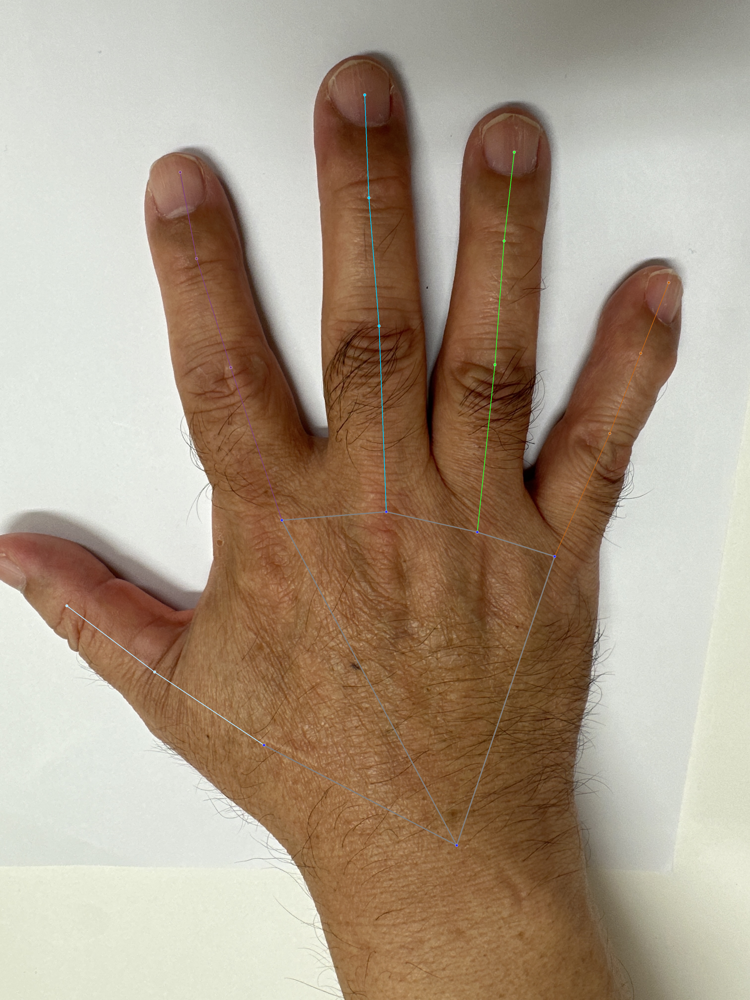

In [5]:
# STEP 1: Import the necessary modules.
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

# STEP 2: HandLandmarkerオブジェクトを作成
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')  # モデルのパスを指定
options = vision.HandLandmarkerOptions(base_options=base_options,
                                       num_hands=2)  # 2つの手を検出する設定
detector = vision.HandLandmarker.create_from_options(options)  # detectorオブジェクトを作成

# STEP 3: 入力画像をロード
image = mp.Image.create_from_file("/content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000008.jpg")  # 画像を読み込む

# STEP 4: 入力画像から手のランドマークを検出
detection_result = detector.detect(image)  # 検出を実行

# STEP 5: 検出結果を処理（この場合は視覚化）
annotated_image = draw_landmarks_on_image(image.numpy_view(), detection_result)  # ランドマークを画像に描画
cv2_imshow(cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))  # RGBからBGRに変換して画像を表示

In [6]:
import os
import cv2
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

In [7]:
joint_names = {
    0: 'WRIST',
    1: 'THUMB_CMC',
    2: 'THUMB_MCP',
    3: 'THUMB_IP',
    4: 'THUMB_TIP',
    5: 'INDEX_FINGER_MCP',
    6: 'INDEX_FINGER_PIP',
    7: 'INDEX_FINGER_DIP',
    8: 'INDEX_FINGER_TIP',
    9: 'MIDDLE_FINGER_MCP',
    10: 'MIDDLE_FINGER_PIP',
    11: 'MIDDLE_FINGER_DIP',
    12: 'MIDDLE_FINGER_TIP',
    13: 'RING_FINGER_MCP',
    14: 'RING_FINGER_PIP',
    15: 'RING_FINGER_DIP',
    16: 'RING_FINGER_TIP',
    17: 'PINKY_MCP',
    18: 'PINKY_PIP',
    19: 'PINKY_DIP',
    20: 'PINKY_TIP'
}

In [8]:
# 入力と出力のディレクトリを設定
input_folder_path = '/content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand'
base_output_folder_path = '/content/drive/MyDrive/OptPhotoFiles/optPhotoFilesProcessed/RA/RA_Right_Hand'

# 出力フォルダが存在しない場合は作成
if not os.path.exists(base_output_folder_path):
  os.makedirs(base_output_folder_path)

In [9]:
WRIST_CROP_SIZE = 900  # ここでwristのクロップサイズを設定します。
import os
import cv2
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

# 画像に手のランドマークを描画する関数
def draw_landmarks_on_image(rgb_image, detection_result):
  hand_landmarks_list = detection_result.hand_landmarks  # 手のランドマークのリスト
  handedness_list = detection_result.handedness  # 手（左か右）の情報のリスト
  annotated_image = np.copy(rgb_image)  # 元の画像をコピー

  # 検出された手に対してループ処理
  for idx in range(len(hand_landmarks_list)):
    hand_landmarks = hand_landmarks_list[idx]
    handedness = handedness_list[idx]

    # ランドマークをプロトコルバッファの形式に変換
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    hand_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in hand_landmarks
    ])

    # ランドマークと接続線を描画
    solutions.drawing_utils.draw_landmarks(
      annotated_image,
      hand_landmarks_proto,
      solutions.hands.HAND_CONNECTIONS,
      solutions.drawing_styles.get_default_hand_landmarks_style(),
      solutions.drawing_styles.get_default_hand_connections_style())

    # 手の境界ボックスの左上隅の座標を取得
    height, width, _ = annotated_image.shape
    x_coordinates = [landmark.x for landmark in hand_landmarks]
    y_coordinates = [landmark.y for landmark in hand_landmarks]
    text_x = int(min(x_coordinates) * width)
    text_y = int(min(y_coordinates) * height) - MARGIN

    # 手（左か右）の情報を画像に描画
    cv2.putText(annotated_image, f"{handedness[0].category_name}",
                (text_x, text_y), cv2.FONT_HERSHEY_DUPLEX,
                FONT_SIZE, HANDEDNESS_TEXT_COLOR, FONT_THICKNESS, cv2.LINE_AA)

  return annotated_image  # 注釈付き画像を返す

In [10]:
image_files = [f for f in os.listdir(input_folder_path) if f.endswith('.jpg')]

for image_file in image_files:
    input_path = os.path.join(input_folder_path, image_file)
    img = mp.Image.create_from_file(input_path)
    img_numpy = img.numpy_view()
    img_rgb = cv2.cvtColor(img_numpy, cv2.COLOR_BGR2RGB)

    base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
    options = vision.HandLandmarkerOptions(base_options=base_options, num_hands=2)
    detector = vision.HandLandmarker.create_from_options(options)

    detection_result = detector.detect(img)
    height, width, _ = img_numpy.shape
    print(f"Successfully read {input_path}")
    print(f"Image dimensions: {img_numpy.shape}")
    print(f"Detected {len(detection_result.hand_landmarks)} hands.")
    if detection_result.hand_landmarks:
      annotated_image = draw_landmarks_on_image(img_numpy, detection_result)
      output_path = os.path.join(base_output_folder_path, f'annotated_{image_file}')
      cv2.imwrite(output_path, cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))

    for idx, hand_landmarks in enumerate(detection_result.hand_landmarks):
      for joint_idx, landmark in enumerate(hand_landmarks):
        x = int(landmark.x * width)
        y = int(landmark.y * height)
        if joint_idx == 0:  # wristの場合
          crop_size = WRIST_CROP_SIZE
        else:
          crop_size = 300
        crop_x1 = max(0, x - crop_size)
        crop_x2 = min(width, x + crop_size)
        crop_y1 = max(0, y - crop_size)
        crop_y2 = min(height, y + crop_size)
        cropped_img = img_numpy[crop_y1:crop_y2, crop_x1:crop_x2]
        # 以下のコードは変更なし
        joint_name = joint_names[joint_idx]
        joint_folder_path = os.path.join(base_output_folder_path, joint_name)
        if not os.path.exists(joint_folder_path):
          os.makedirs(joint_folder_path)
        output_path = os.path.join(joint_folder_path, image_file)
        cv2.imwrite(output_path, cv2.cvtColor(cropped_img, cv2.COLOR_RGB2BGR))

Successfully read /content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000006.jpg
Image dimensions: (3024, 4032, 3)
Detected 1 hands.
Successfully read /content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000008.jpg
Image dimensions: (4032, 3024, 3)
Detected 1 hands.
Successfully read /content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000009.jpg
Image dimensions: (4032, 3024, 3)
Detected 1 hands.
Successfully read /content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000010.jpg
Image dimensions: (4032, 3024, 3)
Detected 1 hands.
Successfully read /content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000011.jpg
Image dimensions: (4032, 3024, 3)
Detected 0 hands.
Successfully read /content/drive/MyDrive/OptPhotoFiles/optPhotoFiles/RA/RA_Right_Hand/patients_000012.jpg
Image dimensions: (4032, 3024, 3)
Detected 0 hands.
Successfully read /content/drive/MyDrive/OptPhotoFil

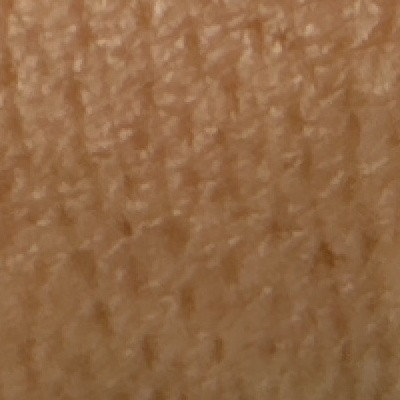

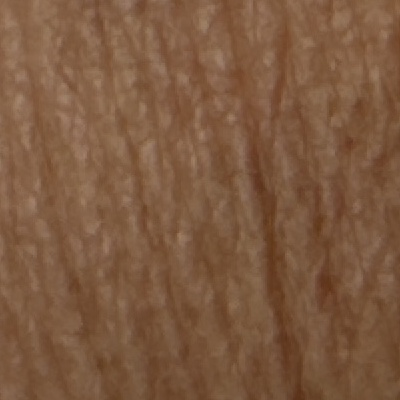

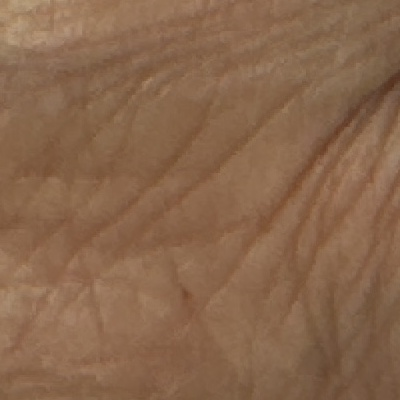

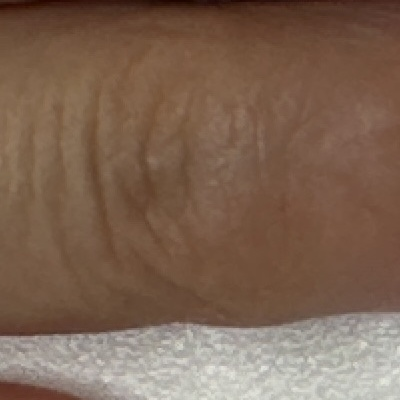

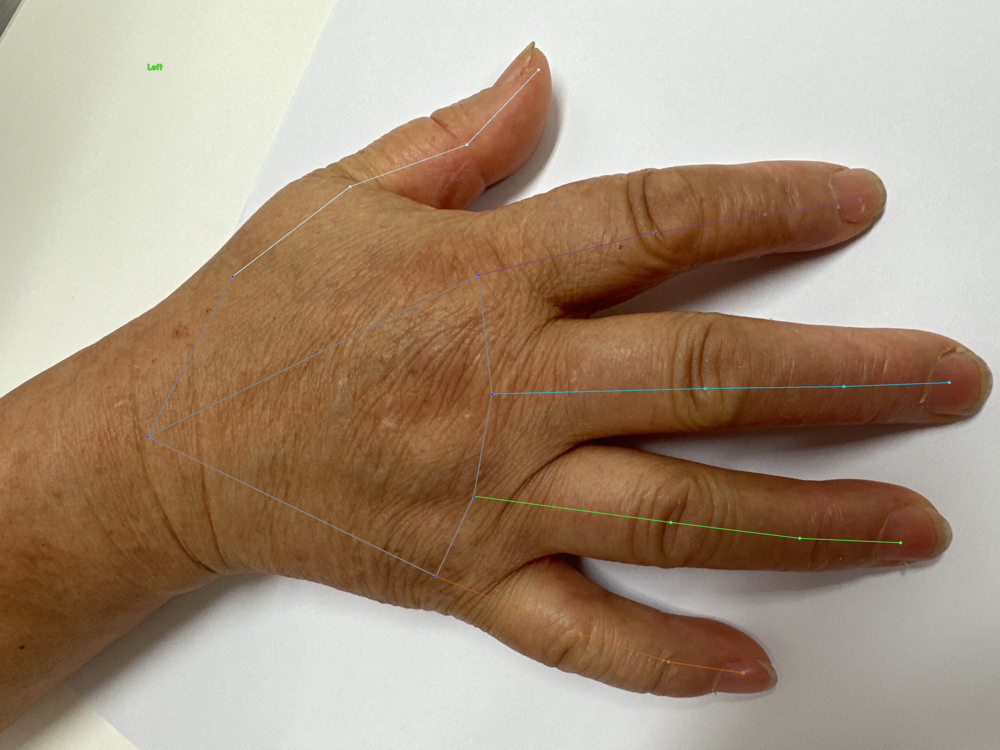

In [11]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/OptPhotoFiles/optPhotoFilesProcessed/RA/RA_Right_Hand/WRIST/image - 上都賀総合病院リウマチ膠原病内科(1).jpg")
cv2_imshow(img)
img = cv2.imread("/content/drive/MyDrive/OptPhotoFiles/optPhotoFilesProcessed/RA/RA_Right_Hand/WRIST/image - 上都賀総合病院リウマチ膠原病内科(104).jpg")
cv2_imshow(img)
img = cv2.imread("/content/drive/MyDrive/OptPhotoFiles/optPhotoFilesProcessed/RA/RA_Right_Hand/RING_FINGER_MCP/image - 上都賀総合病院リウマチ膠原病内科(111).jpg")
cv2_imshow(img)
img = cv2.imread("/content/drive/MyDrive/OptPhotoFiles/optPhotoFilesProcessed/RA/RA_Right_Hand/RING_FINGER_DIP/image - 上都賀総合病院リウマチ膠原病内科(105).jpg")
cv2_imshow(img)
img = cv2.imread("/content/drive/MyDrive/OptPhotoFiles/optPhotoFilesProcessed/RA/RA_Right_Hand/annotated_image - 上都賀総合病院リウマチ膠原病内科(121).jpg")
cv2_imshow(img)